In http://localhost:8891/notebooks/caribbean_disaster_risk/03_1_1_result_qc.ipynb we see a relatively low number of 'concrete', 'incomple' and 'other' roof types

Here we boost these numbers.

NB just sharpening all blurred over theshold of 100 in 05_1_fastai_train_resnet_20191027.ipynb led to slightly worse results

#### Env: 
    
    Use solaris or fastai conda env

In [22]:
from PIL import Image, ImageOps, ImageFilter
from pathlib import Path
from os import listdir
from os.path import isfile, join
from matplotlib import pyplot as plt

import numpy as np
import os
import cv2

import pandas as pd
from shutil import copyfile

In [23]:
data_dir = Path('data')
data_04= Path('data_04')

NB is re-run for different padding types

In [24]:
img_size=256

In [28]:

#BORDER_REFLECT_101
border='reflect'
padded='padded'

In [29]:
#clipped, rotated and reflected images
train_images = data_04/f'train/rotated/clipped/{border}/{img_size}'
test_images = data_04/f'test/rotated/clipped/{border}/{img_size}'
padded_train_images = data_04/f'train/rotated/clipped/{padded}/{border}/{img_size}'
padded_test_images = data_04/f'test/rotated/clipped/{padded}/{border}/{img_size}'

In [30]:
fnames = [f for f in listdir(train_images) if isfile(join(train_images, f))]
tnames = [f for f in listdir(test_images) if isfile(join(test_images, f))]

In [31]:
pfnames = [f for f in listdir(padded_train_images) if isfile(join(padded_train_images, f))]
ptnames = [f for f in listdir(padded_test_images) if isfile(join(padded_test_images, f))]

In [32]:
fnames[0]

'7a348920.tif'

In [33]:
df_all = pd.read_csv(data_dir/'df_train_all.csv')

In [34]:
df_valid=df_all.loc[df_all['verified'] == True]

In [35]:
def mpl_show(new_im, label, title=''):
    plt.imshow(new_im, interpolation = 'bicubic')
    plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
    text = label+' '+title
    plt.title(text)
    plt.show()
    plt.close()

In [36]:
def mpl_2_plot(im1, title1, im2, title2):
    plt.figure(figsize=(8,4))
    plt.subplot(121)
    plt.imshow(im1)
    plt.title(title1, size=12)
    plt.axis('off')
    plt.subplot(122)
    plt.imshow(im2)
    plt.title(title2, size=12)
    plt.axis('off')
    plt.tight_layout()
    plt.show()  

In [37]:
same_train=list(set(pfnames) & set(fnames))
same_test=list(set(ptnames) & set(tnames))

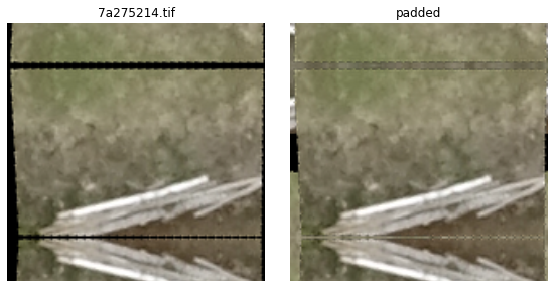

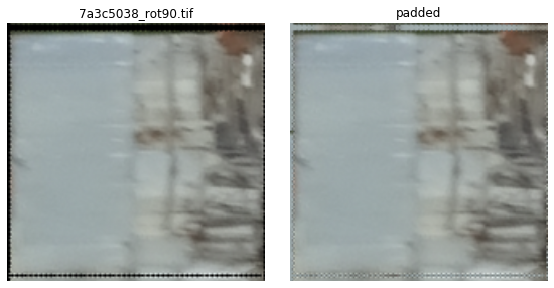

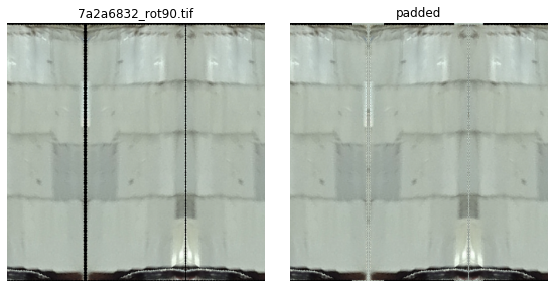

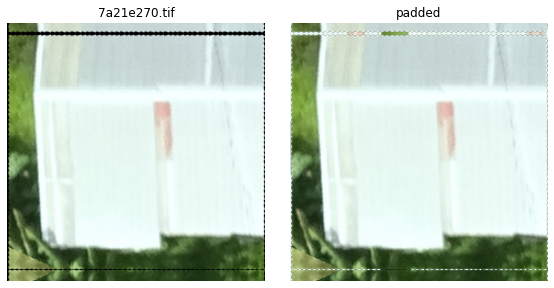

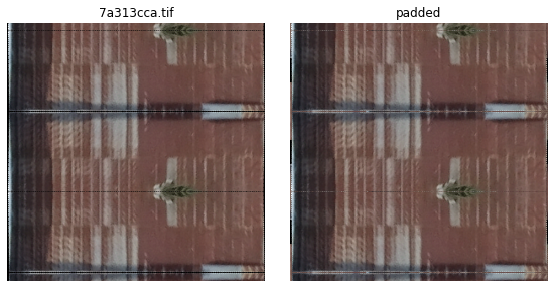

...

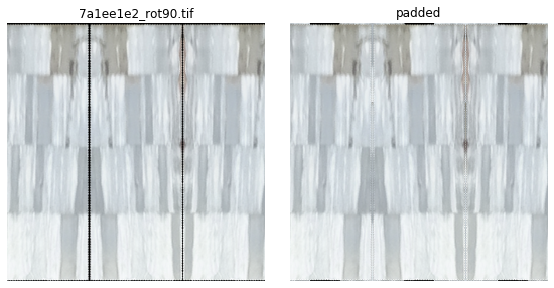

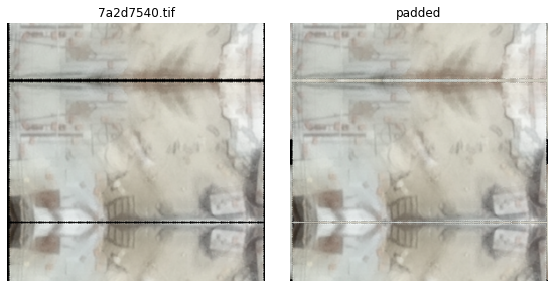

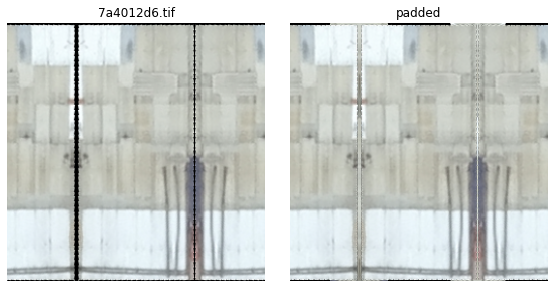

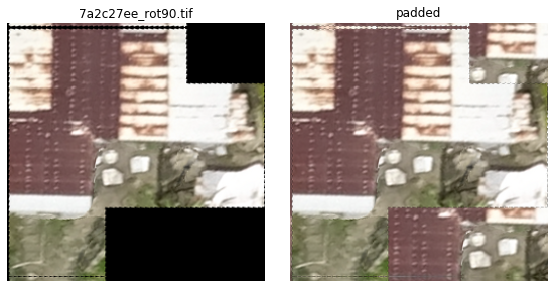

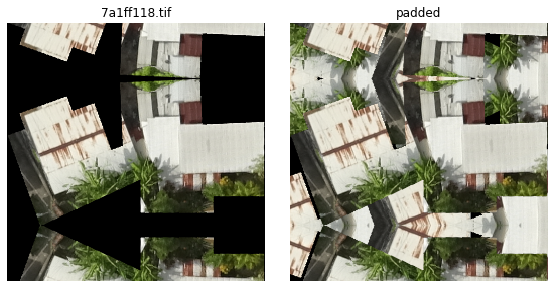

In [42]:
for id in same_train[10:100]:
    im1 = Image.open(train_images/f'{id}')
    im1=cv2.cvtColor(np.array(im1), cv2.COLOR_RGB2BGR)
    im2 = Image.open(padded_train_images/f'{id}')
    mpl_2_plot(im1, f'{id}', im2, 'padded')

#### get ammount of black

(And check the concrete too)

In [30]:
def get_black_frac(pil_img):
    opencvImage = cv2.cvtColor(np.array(im), cv2.COLOR_RGB2BGR)
    gray = cv2.cvtColor(opencvImage, cv2.COLOR_BGR2GRAY)
    count = cv2.countNonZero(gray)
    tot_px=len(im.getdata())
    blk=(tot_px-count)/tot_px
    return blk

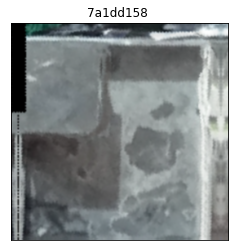

black fraction: 0.029510498046875


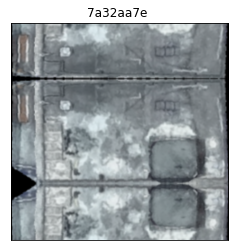

black fraction: 0.0232086181640625


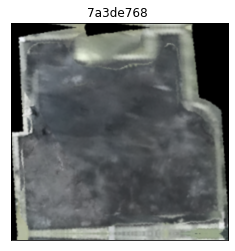

black fraction: 0.1134796142578125


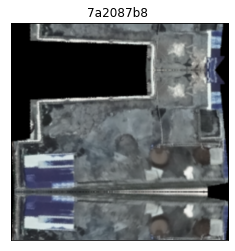

black fraction: 0.20770263671875


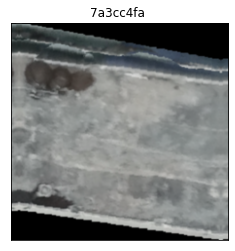

black fraction: 0.1509552001953125


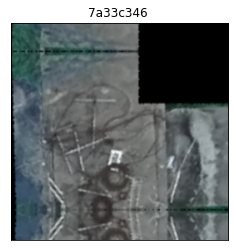

black fraction: 0.164581298828125


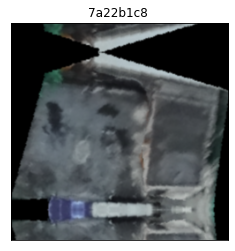

black fraction: 0.2465972900390625


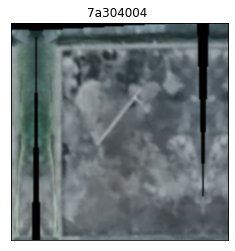

black fraction: 0.04840087890625


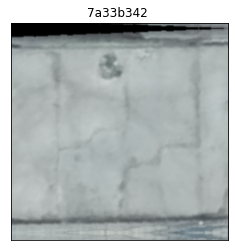

black fraction: 0.0334014892578125


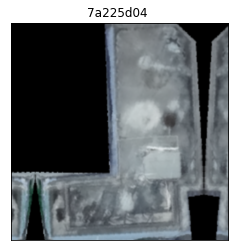

black fraction: 0.3776702880859375


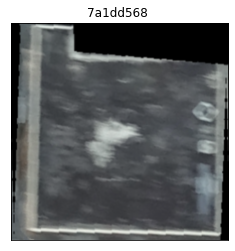

black fraction: 0.1578521728515625


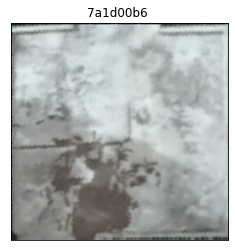

black fraction: 0.003387451171875


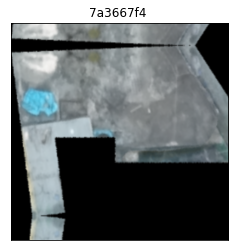

black fraction: 0.4002685546875


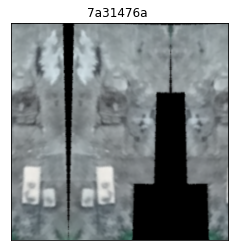

black fraction: 0.1695098876953125


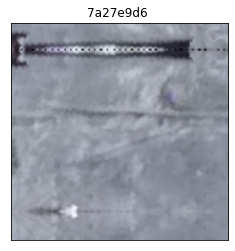

black fraction: 0.000244140625


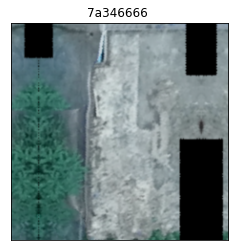

black fraction: 0.141632080078125


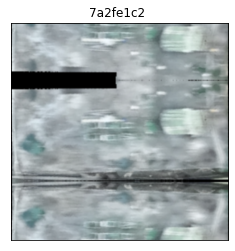

black fraction: 0.042144775390625


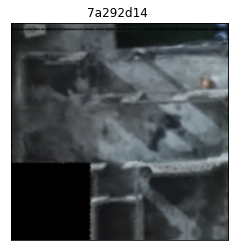

black fraction: 0.1317138671875


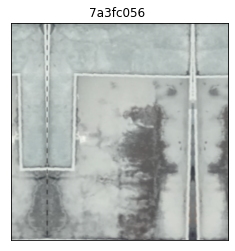

black fraction: 0.0


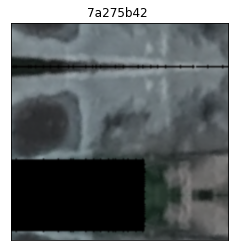

black fraction: 0.2015533447265625


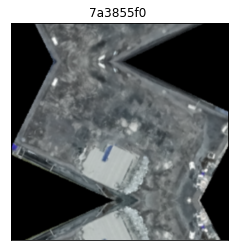

black fraction: 0.302581787109375


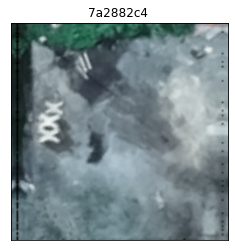

black fraction: 0.00677490234375


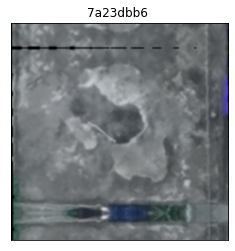

black fraction: 0.010406494140625


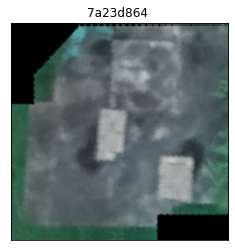

black fraction: 0.1066741943359375


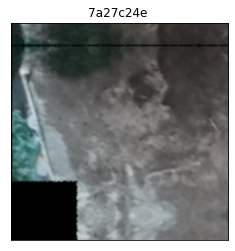

black fraction: 0.0850677490234375


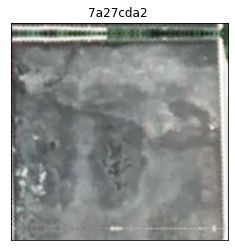

black fraction: 0.00091552734375


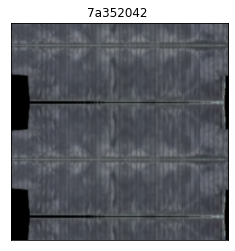

black fraction: 0.0542755126953125


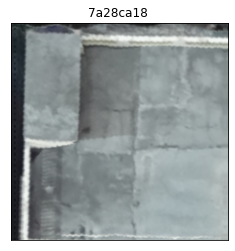

black fraction: 0.000762939453125


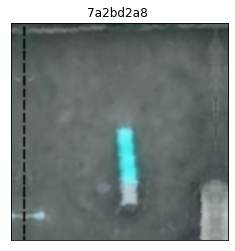

black fraction: 0.0026397705078125


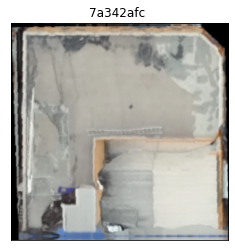

black fraction: 0.0391845703125


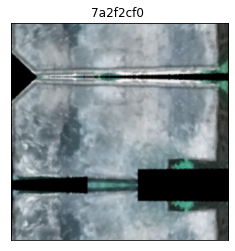

black fraction: 0.107421875


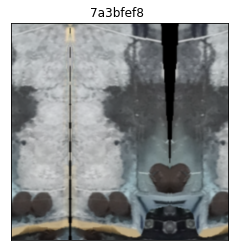

black fraction: 0.027374267578125


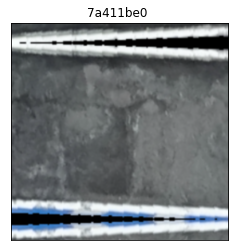

black fraction: 0.04534912109375


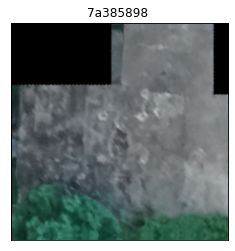

black fraction: 0.1541900634765625


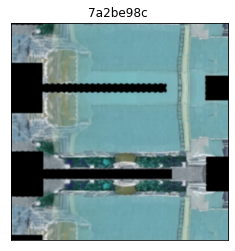

black fraction: 0.14459228515625


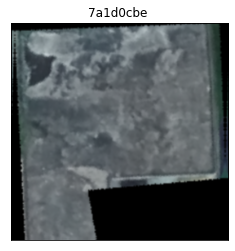

black fraction: 0.2202301025390625


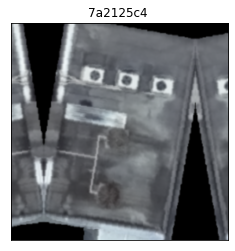

black fraction: 0.1671905517578125


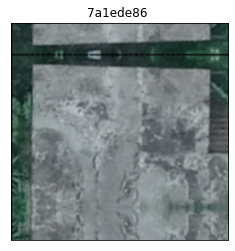

black fraction: 0.006011962890625


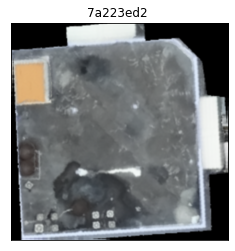

black fraction: 0.1586151123046875


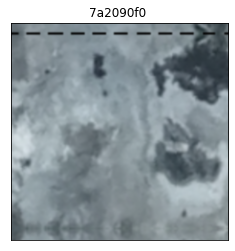

black fraction: 0.0021820068359375


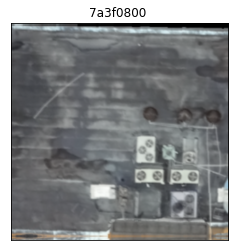

black fraction: 0.012725830078125


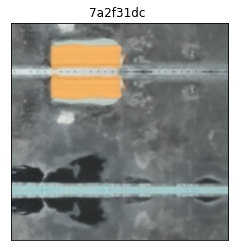

black fraction: 0.0


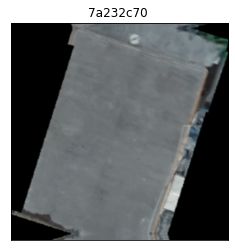

black fraction: 0.3129425048828125


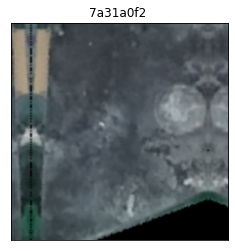

black fraction: 0.0630340576171875


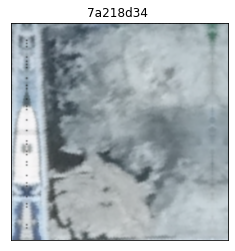

black fraction: 0.0005645751953125


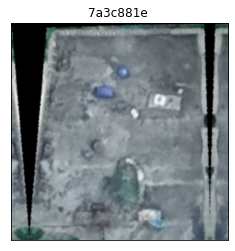

black fraction: 0.1120758056640625


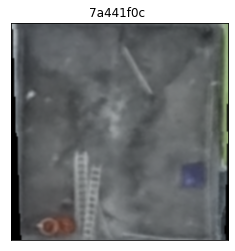

black fraction: 0.026458740234375


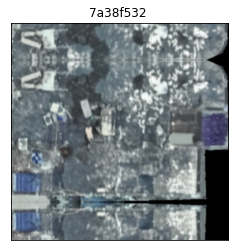

black fraction: 0.05792236328125


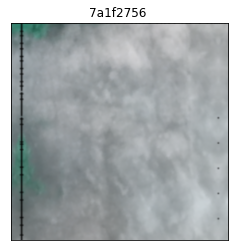

black fraction: 0.00384521484375


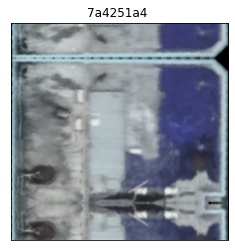

black fraction: 0.0051116943359375


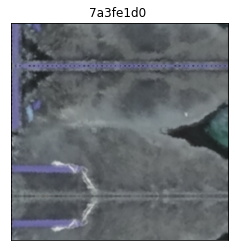

black fraction: 0.002288818359375


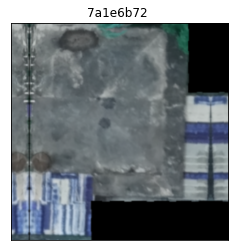

black fraction: 0.1721343994140625


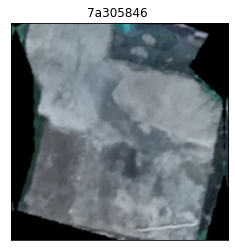

black fraction: 0.1639251708984375


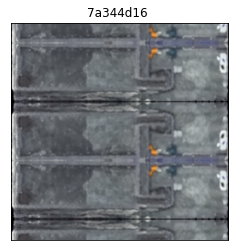

black fraction: 0.007232666015625


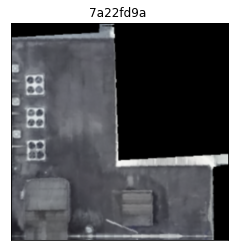

black fraction: 0.3665924072265625


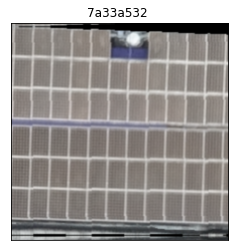

black fraction: 0.0380859375


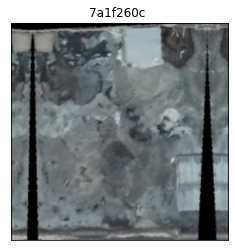

black fraction: 0.0775909423828125


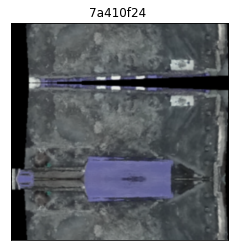

black fraction: 0.0996856689453125


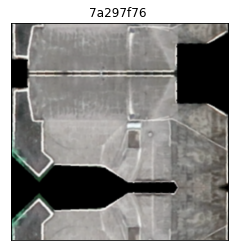

black fraction: 0.17816162109375


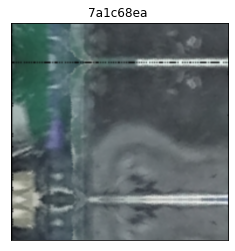

black fraction: 0.004791259765625


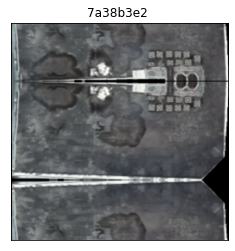

black fraction: 0.0345306396484375


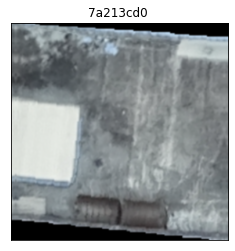

black fraction: 0.075531005859375


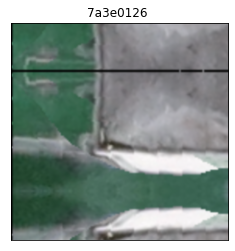

black fraction: 0.007171630859375


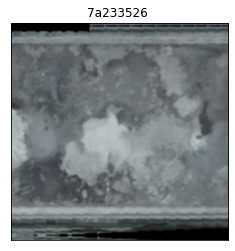

black fraction: 0.041839599609375


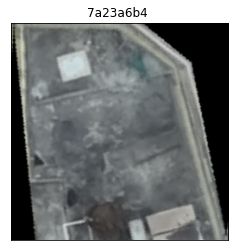

black fraction: 0.17999267578125


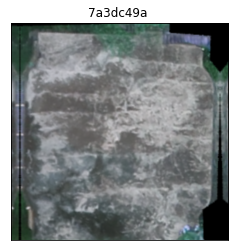

black fraction: 0.0609893798828125


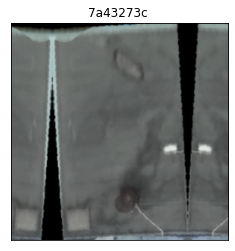

black fraction: 0.0855712890625


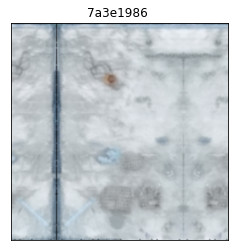

black fraction: 1.52587890625e-05


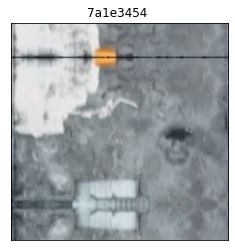

black fraction: 7.62939453125e-05


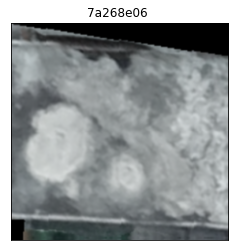

black fraction: 0.0851898193359375


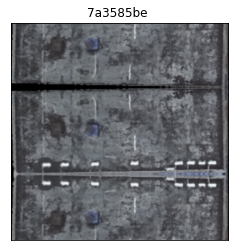

black fraction: 0.0215606689453125


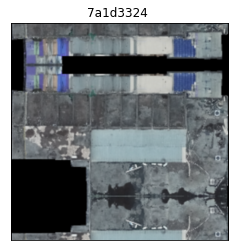

black fraction: 0.1893310546875


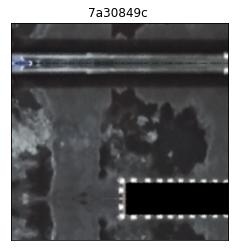

black fraction: 0.06829833984375


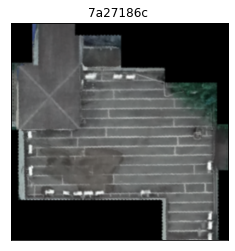

black fraction: 0.3157501220703125


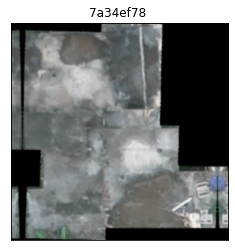

black fraction: 0.2732391357421875


In [31]:
for id in ids:
    im = Image.open(train_images/f'{id}.tif')
    mpl_show(im, label=id, title='')
    blk=get_black_frac(im)
    print(f'black fraction: {blk}')

All are concrete, so OK to put these in the gold set

15% seems to be a reasonable cutoff for using padded bg

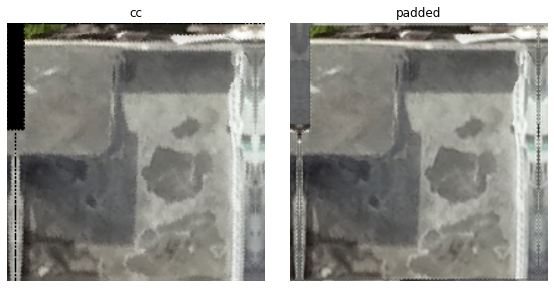

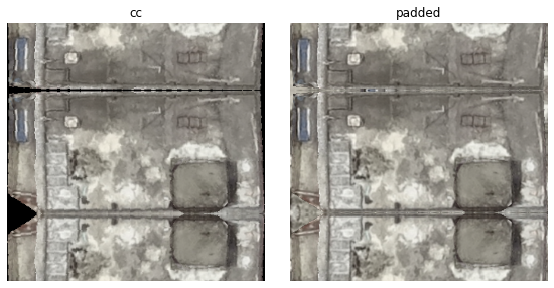

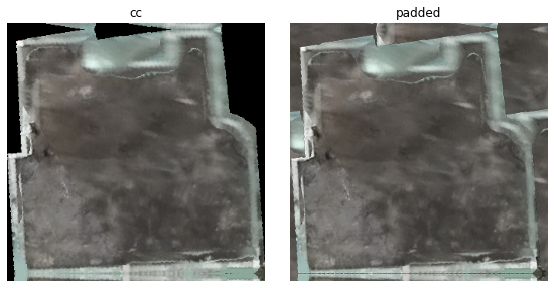

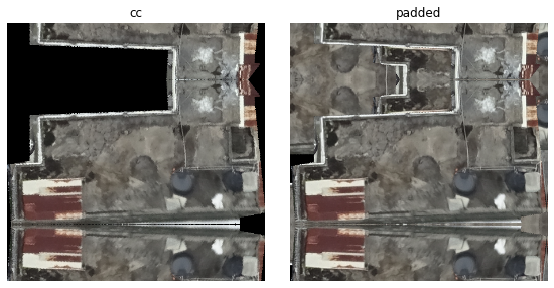

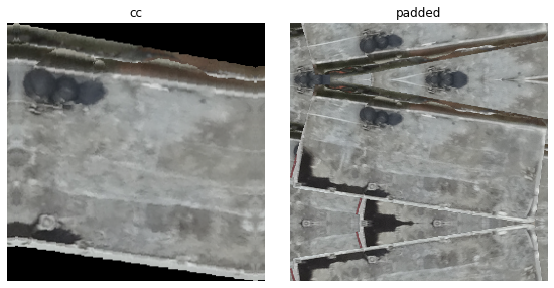

...

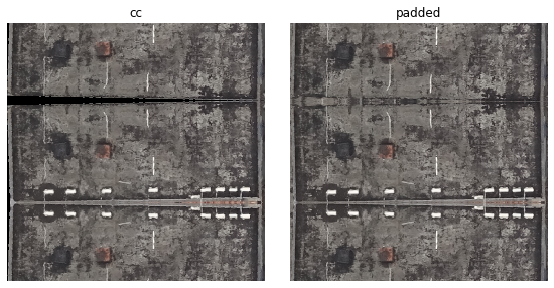

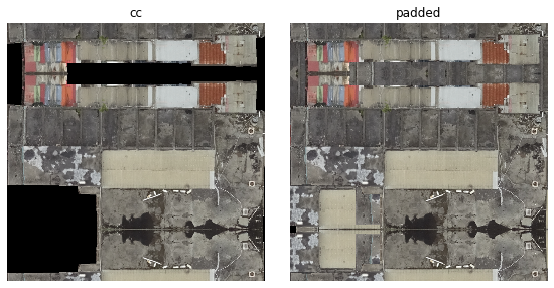

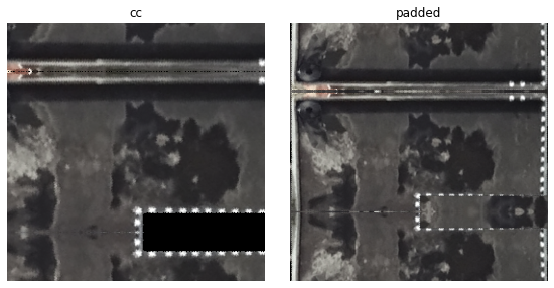

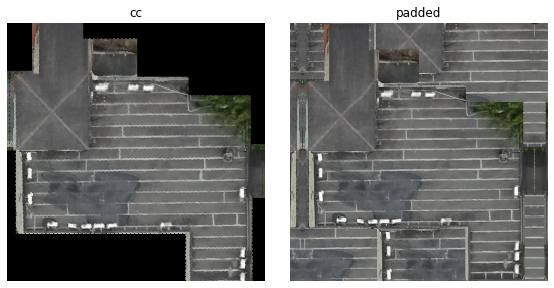

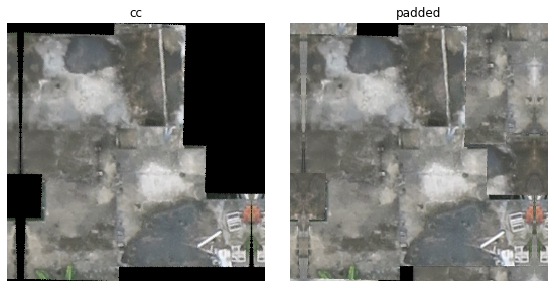

In [32]:
padded_images = data_02/f'train/rotated/clipped/padded/{border}/{img_size}'
for id in ids:
    im1 = Image.open(train_images/f'{id}.tif')
    im1=cv2.cvtColor(np.array(im1), cv2.COLOR_RGB2BGR)
    im2 = Image.open(padded_images/f'{id}.tif')
    blk=get_black_frac(im1)
    if blk>=0.15:
        mpl_2_plot(im1, 'cc', im2, 'padded')

In [33]:
### create new dataset - >15% black repaced with padded images

In [34]:
def open_im(fpath):
    im1 = Image.open(fpath)
    im1=cv2.cvtColor(np.array(im1), cv2.COLOR_RGB2BGR)
    return im1

In [35]:
pad_type='padded'

In [36]:
train_relect_images=data_02/f'train/rotated/clipped/{border}/{img_size}'
test_reflect_images=data_02/f'test/rotated/clipped/{border}/{img_size}'
train_pad_relect_images=data_02/f'train/rotated/clipped/{pad_type}/{border}/{img_size}'
test_pad_reflect_images=data_02/f'test/rotated/clipped/{pad_type}/{border}/{img_size}'

In [37]:
trnames = [f for f in listdir(train_relect_images) if isfile(join(train_relect_images, f))]
tenames = [f for f in listdir(test_reflect_images) if isfile(join(test_reflect_images, f))]
ptrames = [f for f in listdir(train_pad_relect_images) if isfile(join(train_pad_relect_images, f))]
ptenames = [f for f in listdir(test_pad_reflect_images) if isfile(join(test_pad_reflect_images, f))]

In [38]:
trnames[0]

'7a375650_rot90.tif'

In [39]:
tdir=data_02/f'train/rotated/clipped/{border}/blk_cutoff_25'
tdir.mkdir(exist_ok=True)
train_blk_frac_images=data_02/f'train/rotated/clipped/{border}/blk_cutoff_25/{img_size}'
train_blk_frac_images.mkdir(exist_ok=True)

tdir=data_02/f'test/rotated/clipped/{border}/blk_cutoff_25'
tdir.mkdir(exist_ok=True)
test_blk_frac_images=data_02/f'test/rotated/clipped/{border}/blk_cutoff_25/{img_size}'
test_blk_frac_images.mkdir(exist_ok=True)

In [40]:
for im_nm in trnames:
    img=open_im(train_relect_images/f'{im_nm}')
    blk=get_black_frac(im1)
    if blk>=0.25:
        copyfile(train_pad_relect_images/f'{im_nm}', train_blk_frac_images/f'{im_nm}')
    else:
        copyfile(train_relect_images/f'{im_nm}', train_blk_frac_images/f'{im_nm}')

In [41]:
for im_nm in tenames:
    img=open_im(test_reflect_images/f'{im_nm}')
    blk=get_black_frac(im1)
    if blk>=0.25:
        copyfile(test_pad_reflect_images/f'{im_nm}', test_blk_frac_images/f'{im_nm}')
    else:
        copyfile(train_relect_images/f'{im_nm}', test_blk_frac_images/f'{im_nm}')